# Generative Adversarial Networks


In [74]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [75]:
from gan.train import train

In [76]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# GAN loss functions

### GAN loss

We Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [77]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

We Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$




In [78]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

We Implement the `Discriminator` and `Generator` networks in `gan/models.py`.


**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Use padding = 1 (not 0) for all the convolutional layers.

Instead of Relu we use LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). You can use simply use relu as well.

The output of your discriminator should be a single value score corresponding to each input sample.

**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [79]:
from gan.models import Discriminator, Generator

# Data loading

The cat images we provide are RGB images with a resolution of 64x64. In order to prevent our discriminator from overfitting, we will need to perform some data augmentation.


In [80]:
batch_size = 32
imsize = 64
cat_root = './cats'

cat_train = ImageFolder(root=cat_root, transform=transforms.Compose([
    transforms.ToTensor(),
    
    # Example use of RandomCrop:
    transforms.Resize(int(1.15 * imsize)),
    transforms.RandomCrop(imsize),
    #transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1),
    #transforms.Normalize(mean=[0.3,0.3, 0.3],std=[0.5, 0.5, 0.5])  # Normalize pixel values
    #transforms.RandomVerticalFlip(p=0.5),       # Random horizontal flip with 50% probability
    #transforms.RandomHorizontalFlip(p=0.5)
    #transforms.RandomRotation(degrees=10)        # Random rotation by up to 10 degrees


    transforms.RandomAdjustSharpness(sharpness_factor=0.9)

    

]))

cat_loader_train = DataLoader(cat_train, batch_size=batch_size, drop_last=True,shuffle=True)





### Visualize dataset

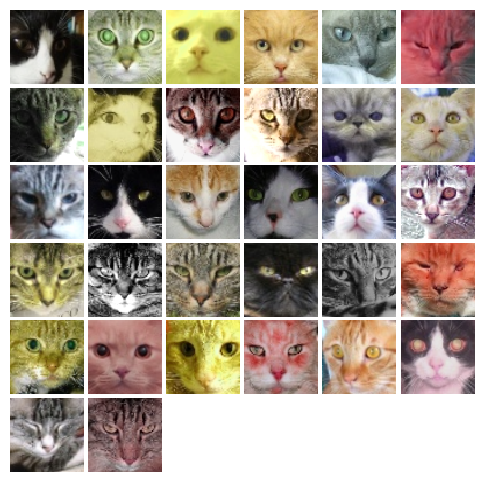

In [81]:
from gan.utils import show_images

imgs = cat_loader_train.__iter__().__next__()[0].numpy().squeeze()
show_images(imgs, color=True)

# Training 




In [24]:
NOISE_DIM = 100
NUM_EPOCHS = 20
learning_rate = 0.001

### Train GAN

In [25]:
import torch
import torch.nn as nn

In [26]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [27]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

In [ ]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss, 
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)


### Train LS-GAN

In [40]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.00005

In [41]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [42]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.6562, G:0.2741


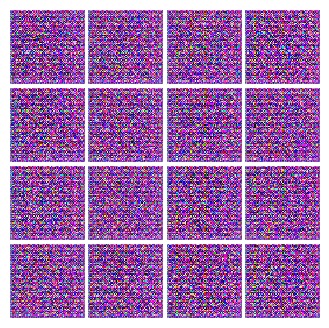


Iter: 250, D: 0.007968, G:1.214


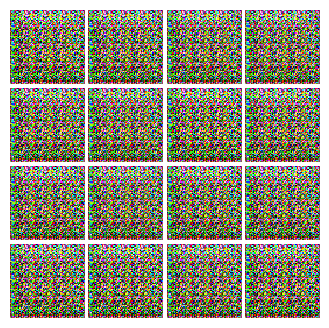


EPOCH:  2
Iter: 500, D: 0.04694, G:1.596


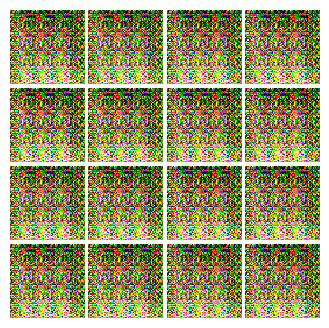


Iter: 750, D: 0.1461, G:0.4706


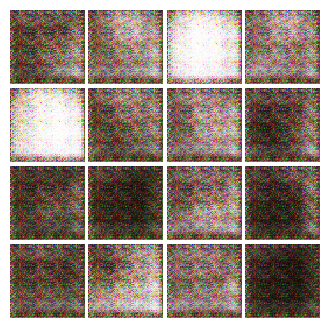


EPOCH:  3
Iter: 1000, D: 0.1841, G:0.5713


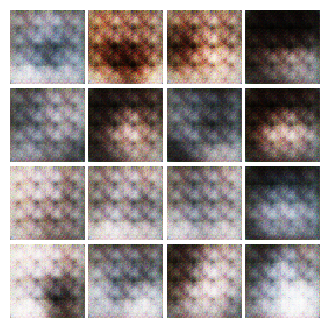


Iter: 1250, D: 0.1225, G:1.16


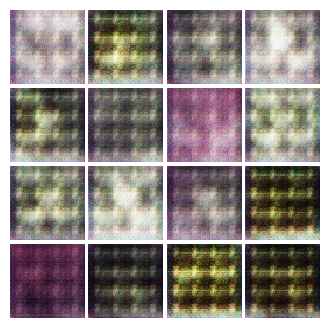


EPOCH:  4
Iter: 1500, D: 0.1164, G:0.6421


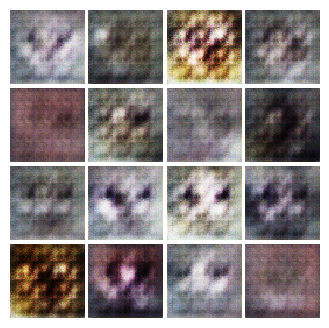


Iter: 1750, D: 0.1637, G:1.382


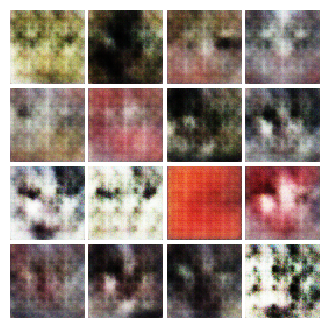


EPOCH:  5
Iter: 2000, D: 0.1341, G:0.6744


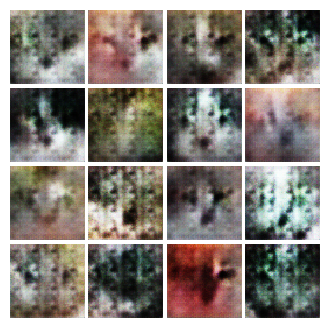


Iter: 2250, D: 0.0365, G:0.9886


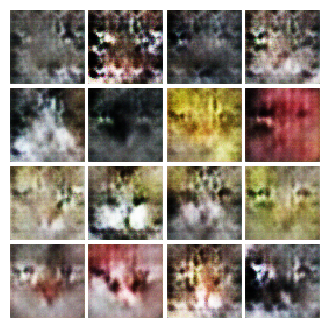


EPOCH:  6
Iter: 2500, D: 0.06983, G:1.056


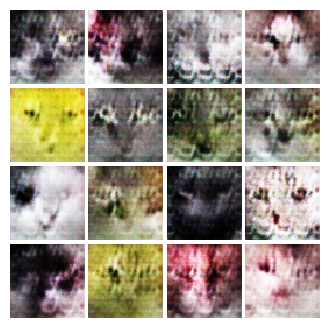


Iter: 2750, D: 0.05427, G:1.35


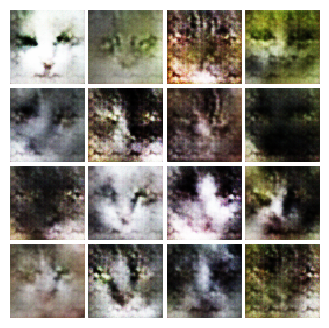


EPOCH:  7
Iter: 3000, D: 0.3097, G:0.5823


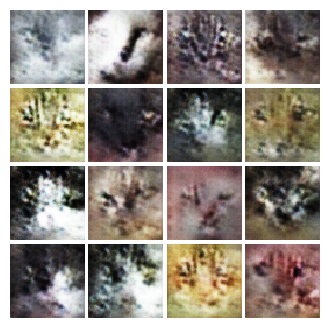


Iter: 3250, D: 0.06452, G:0.9634


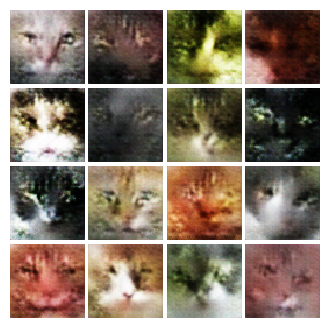


EPOCH:  8
Iter: 3500, D: 0.0551, G:0.9768


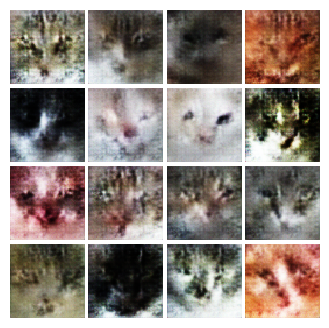


Iter: 3750, D: 0.05005, G:0.7988


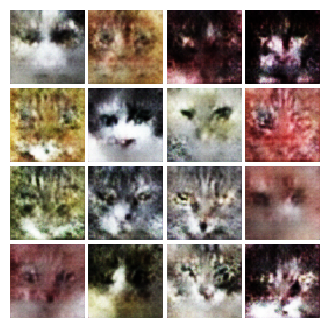


EPOCH:  9
Iter: 4000, D: 0.05364, G:1.188


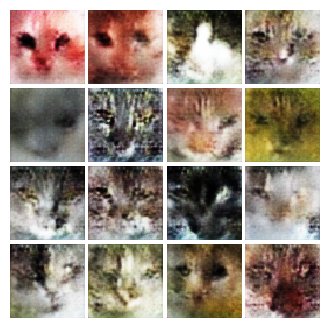


Iter: 4250, D: 0.02396, G:0.7689


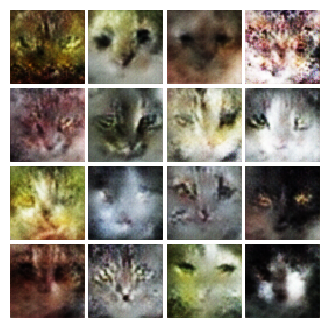


EPOCH:  10
Iter: 4500, D: 0.1128, G:0.666


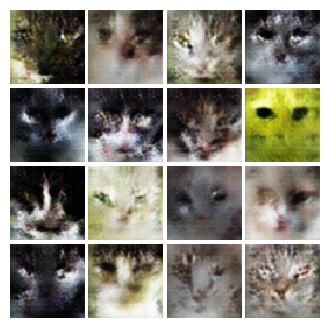


Iter: 4750, D: 0.0869, G:0.7989


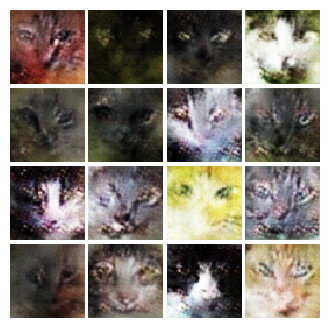


EPOCH:  11
Iter: 5000, D: 0.01681, G:0.9919


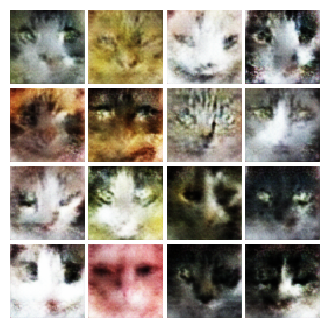


Iter: 5250, D: 0.02899, G:0.8105


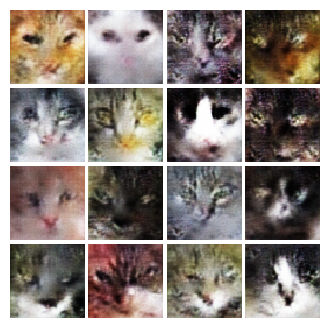


EPOCH:  12
Iter: 5500, D: 0.05086, G:0.9564


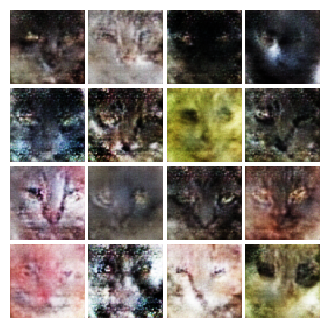


Iter: 5750, D: 0.05156, G:1.109


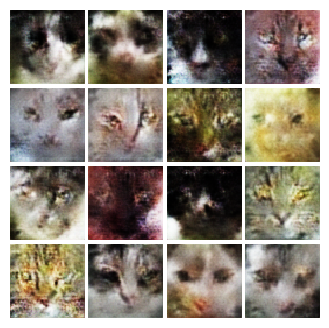


EPOCH:  13
Iter: 6000, D: 0.01155, G:0.9401


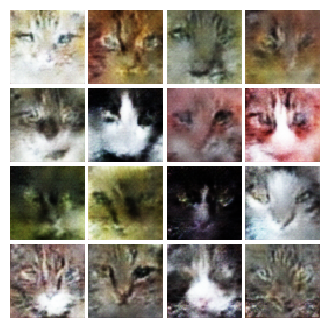


Iter: 6250, D: 0.05202, G:1.356


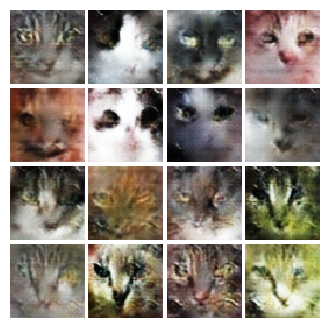


EPOCH:  14
Iter: 6500, D: 0.04937, G:0.6441


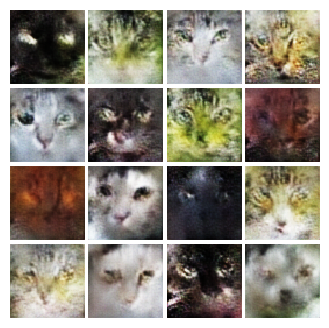


Iter: 6750, D: 0.066, G:0.6468


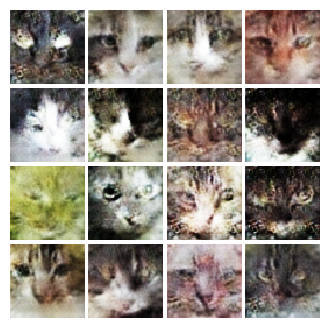


EPOCH:  15
Iter: 7000, D: 0.09774, G:0.8184


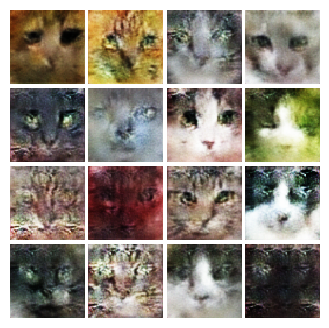


Iter: 7250, D: 0.03659, G:0.737


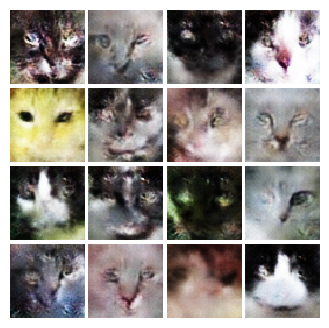


EPOCH:  16
Iter: 7500, D: 0.1325, G:0.8056


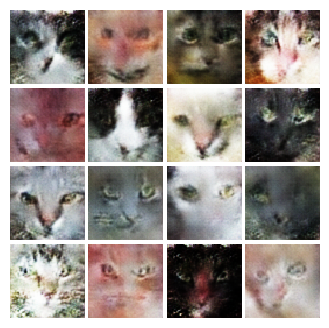


Iter: 7750, D: 0.02822, G:0.8778


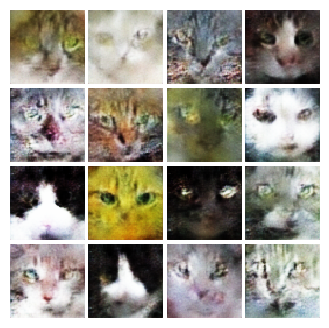


EPOCH:  17
Iter: 8000, D: 0.01857, G:1.109


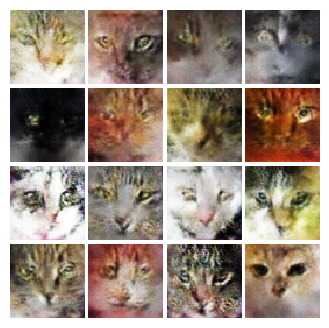


Iter: 8250, D: 0.02828, G:1.087


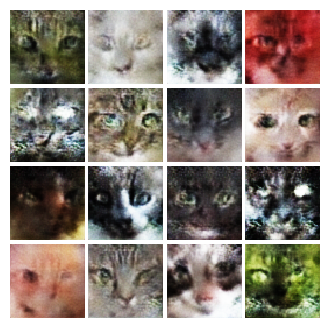


EPOCH:  18
Iter: 8500, D: 0.1564, G:0.6776


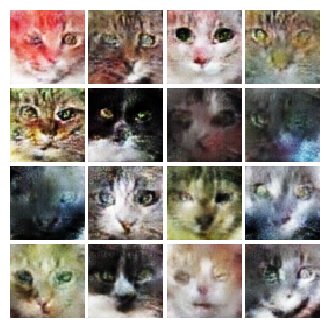


Iter: 8750, D: 0.01275, G:1.063


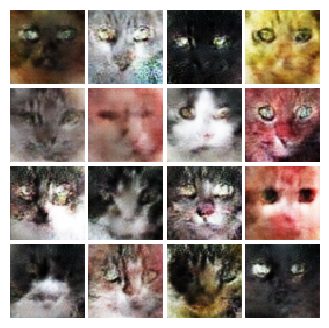


EPOCH:  19
Iter: 9000, D: 0.05046, G:0.8993


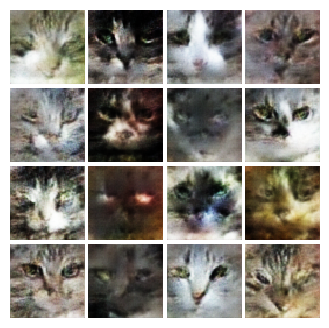


Iter: 9250, D: 0.02988, G:0.7844


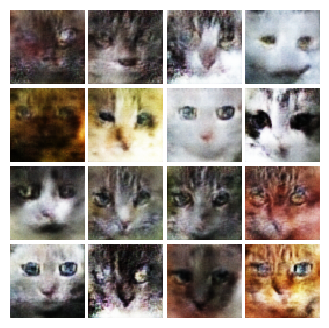


EPOCH:  20
Iter: 9500, D: 0.01679, G:0.7126


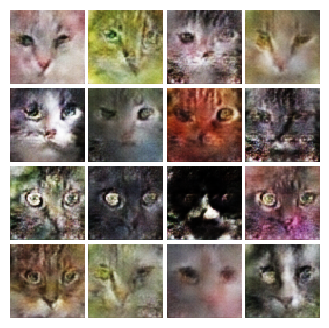


Iter: 9750, D: 0.01344, G:0.8239


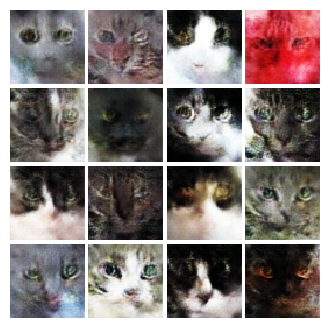


EPOCH:  21
Iter: 10000, D: 0.01797, G:1.125


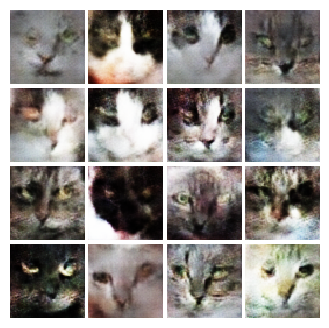


Iter: 10250, D: 0.05591, G:1.24


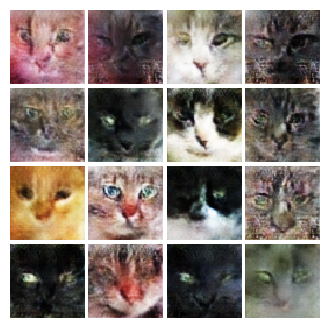


EPOCH:  22
Iter: 10500, D: 0.02546, G:0.9193


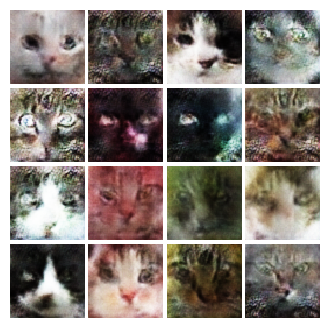


Iter: 10750, D: 0.02278, G:0.9619


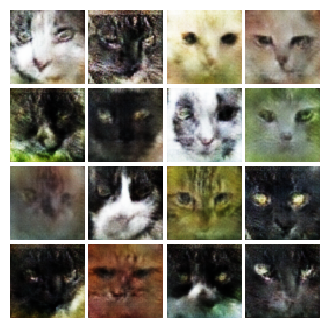


EPOCH:  23
Iter: 11000, D: 0.0395, G:1.188


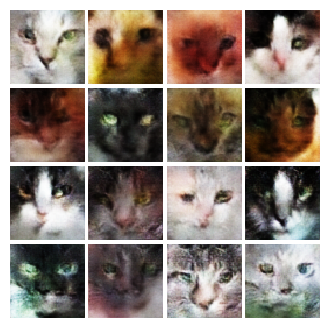


Iter: 11250, D: 0.05494, G:0.8531


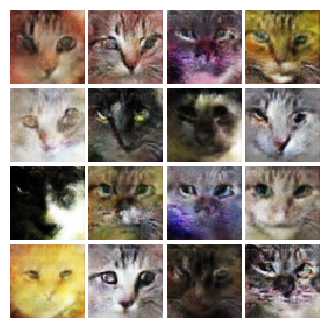


EPOCH:  24
Iter: 11500, D: 0.03691, G:0.5443


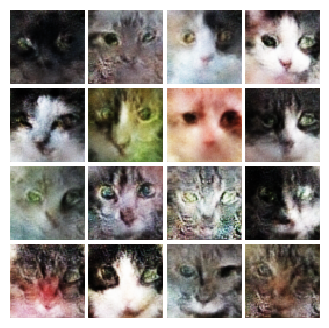


Iter: 11750, D: 0.03755, G:0.9431


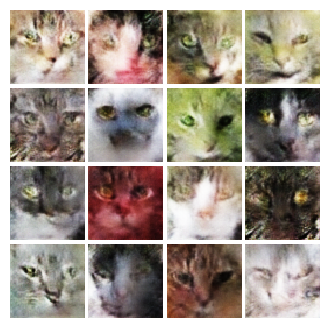


EPOCH:  25
Iter: 12000, D: 0.02707, G:0.7411


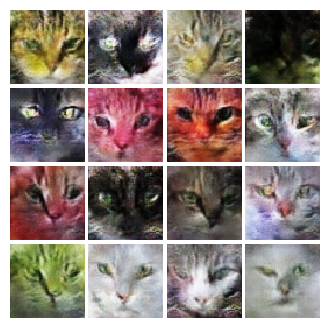


Iter: 12250, D: 0.01904, G:0.838


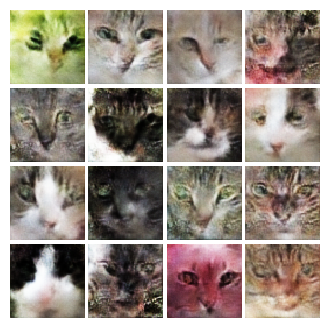


EPOCH:  26
Iter: 12500, D: 0.1003, G:0.6658


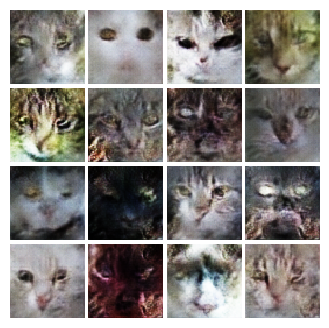


Iter: 12750, D: 0.01682, G:1.275


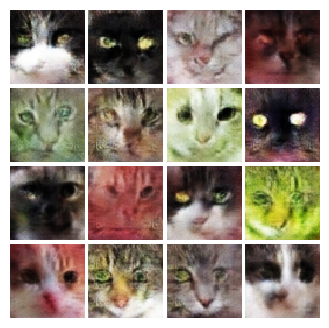


EPOCH:  27
Iter: 13000, D: 0.01718, G:0.7156


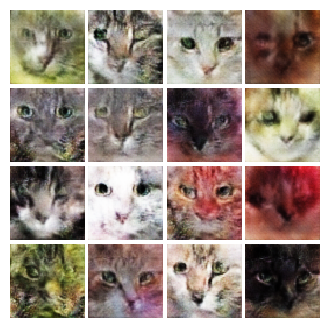


Iter: 13250, D: 0.04968, G:0.8007


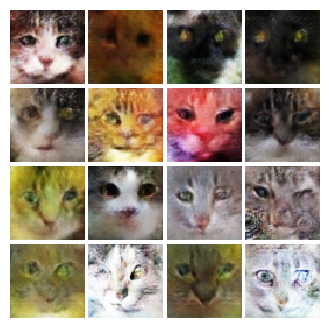


EPOCH:  28
Iter: 13500, D: 0.01699, G:0.9053


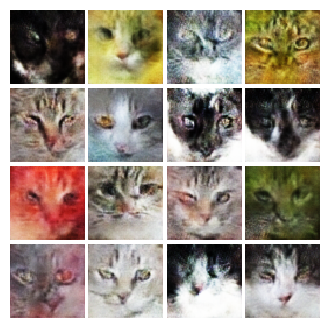


Iter: 13750, D: 0.03933, G:0.6811


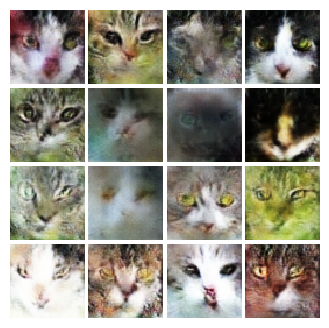


EPOCH:  29
Iter: 14000, D: 0.01617, G:1.038


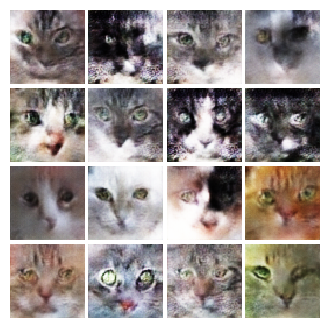


Iter: 14250, D: 0.01235, G:0.8318


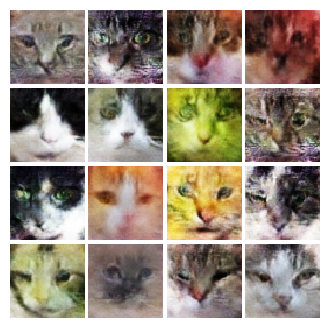


EPOCH:  30
Iter: 14500, D: 0.01127, G:1.45


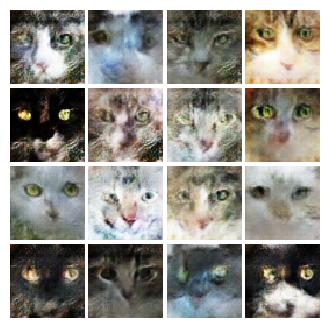


Iter: 14750, D: 0.06735, G:1.054


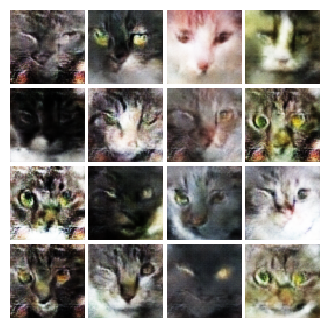


EPOCH:  31
Iter: 15000, D: 0.01317, G:1.2


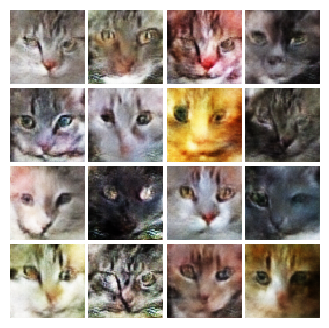


Iter: 15250, D: 0.06053, G:1.259


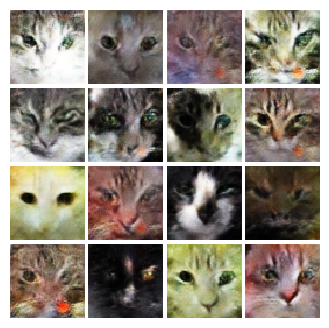


EPOCH:  32
Iter: 15500, D: 0.03695, G:1.102


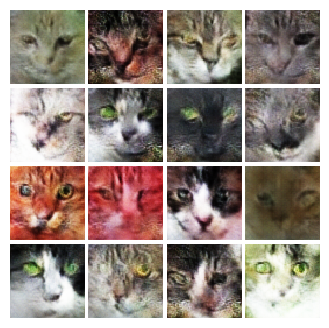


EPOCH:  33
Iter: 15750, D: 0.01041, G:0.9782


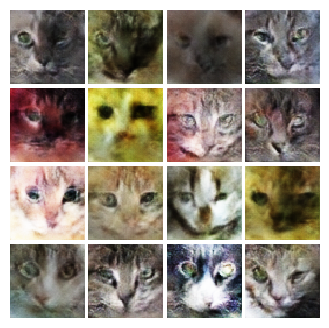


Iter: 16000, D: 0.06104, G:0.7851


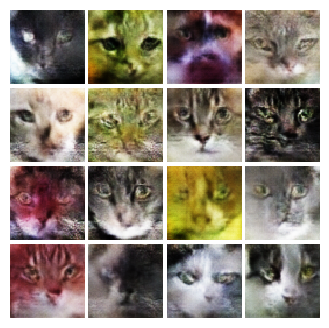


EPOCH:  34
Iter: 16250, D: 0.006619, G:0.7461


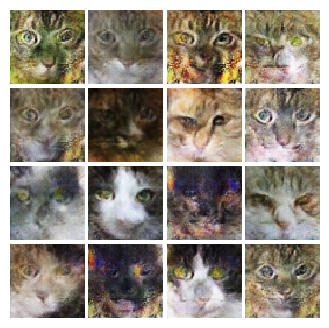


Iter: 16500, D: 0.0224, G:0.8603


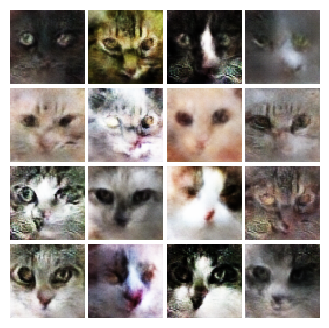


EPOCH:  35
Iter: 16750, D: 0.01756, G:0.9169


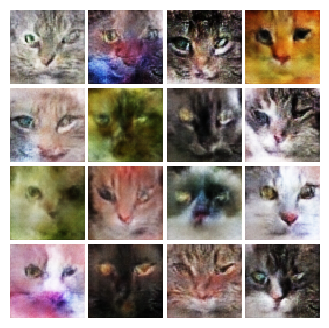


Iter: 17000, D: 0.01113, G:0.8684


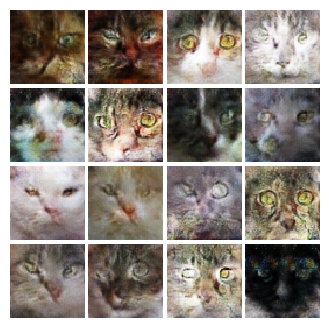


EPOCH:  36
Iter: 17250, D: 0.09326, G:1.434


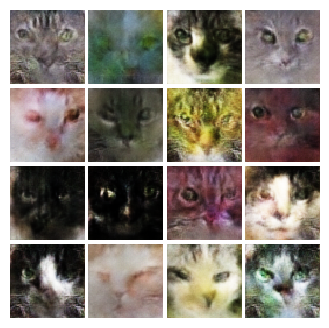


Iter: 17500, D: 0.02397, G:0.881


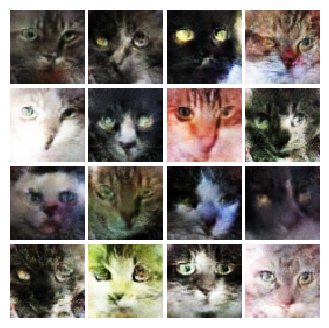


EPOCH:  37
Iter: 17750, D: 0.0125, G:0.8965


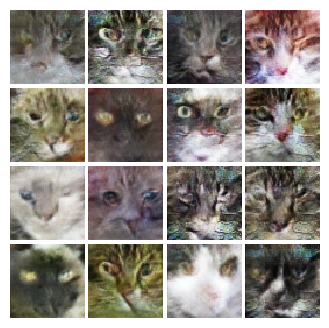


Iter: 18000, D: 0.1111, G:1.089


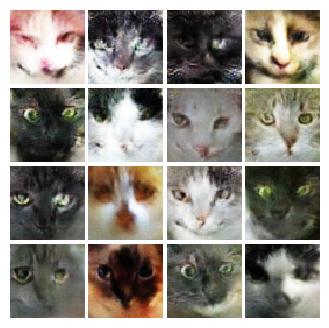


EPOCH:  38
Iter: 18250, D: 0.0113, G:0.901


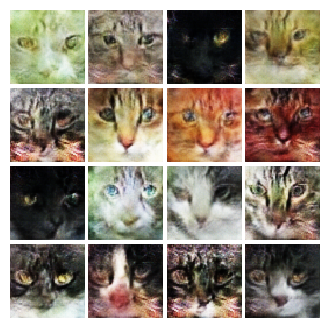


Iter: 18500, D: 0.04769, G:0.6009


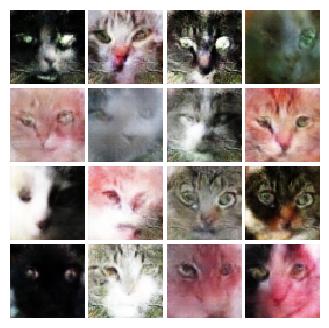


EPOCH:  39
Iter: 18750, D: 0.01785, G:0.9644


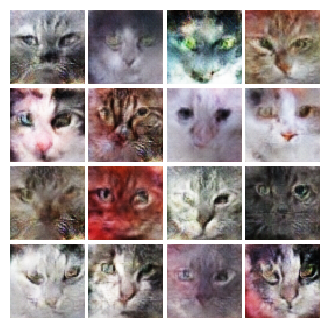


Iter: 19000, D: 0.01202, G:1.033


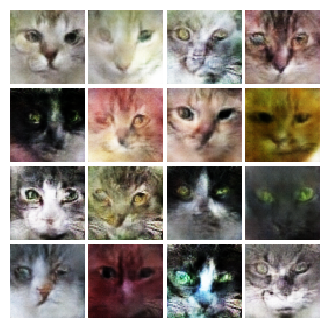


EPOCH:  40
Iter: 19250, D: 0.02889, G:1.05


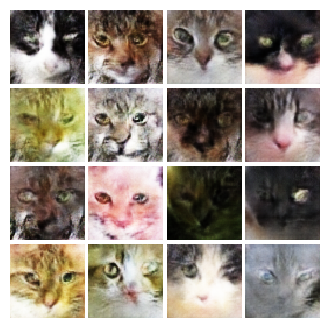


Iter: 19500, D: 0.007059, G:1.024


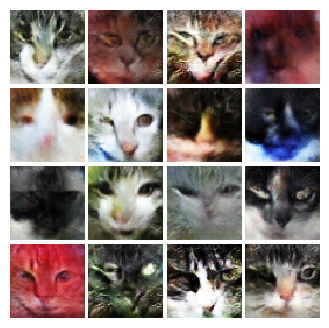


EPOCH:  41
Iter: 19750, D: 0.06059, G:1.461


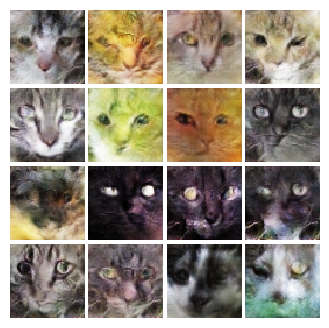


Iter: 20000, D: 0.01985, G:0.5017


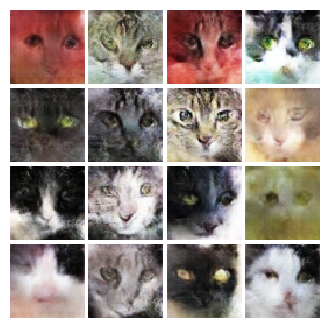


EPOCH:  42
Iter: 20250, D: 0.01762, G:0.7082


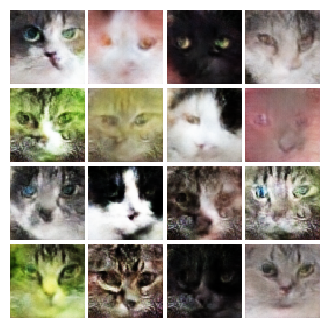


Iter: 20500, D: 0.015, G:0.9966


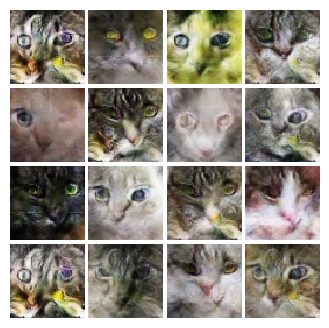


EPOCH:  43
Iter: 20750, D: 0.0105, G:0.7909


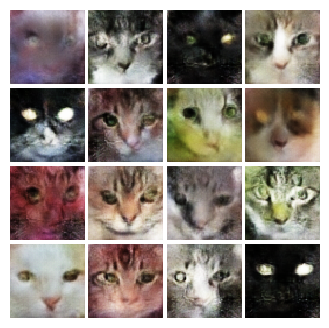


Iter: 21000, D: 0.02588, G:0.9175


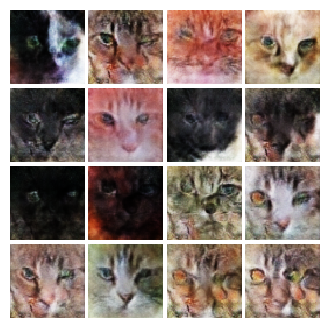


EPOCH:  44
Iter: 21250, D: 0.1263, G:1.004


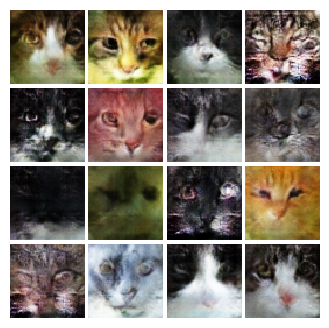


Iter: 21500, D: 0.03895, G:0.9635


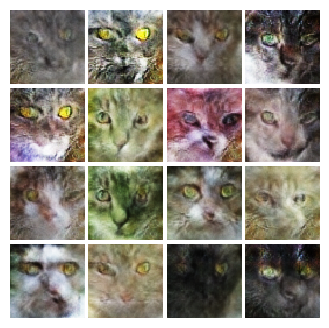


EPOCH:  45
Iter: 21750, D: 0.03673, G:0.8054


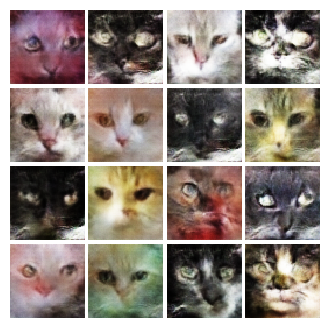


Iter: 22000, D: 0.01135, G:0.8498


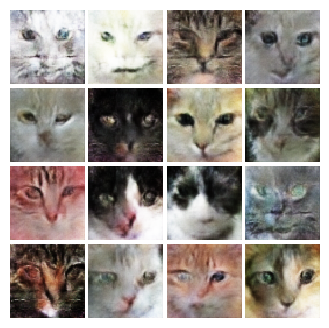


EPOCH:  46
Iter: 22250, D: 0.114, G:1.271


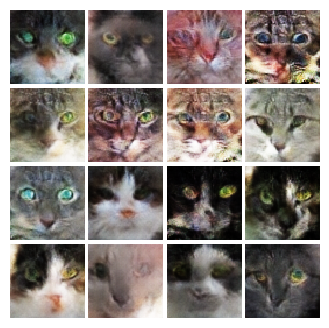


Iter: 22500, D: 0.008139, G:1.075


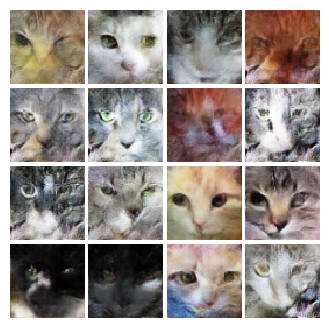


EPOCH:  47
Iter: 22750, D: 0.0145, G:0.8996


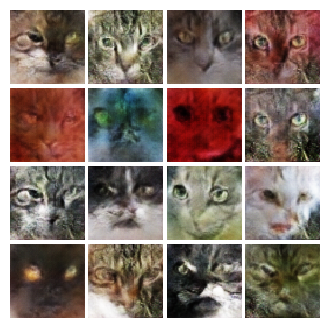


Iter: 23000, D: 0.04658, G:1.019


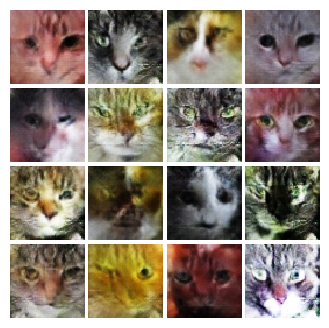


EPOCH:  48
Iter: 23250, D: 0.0144, G:0.6447


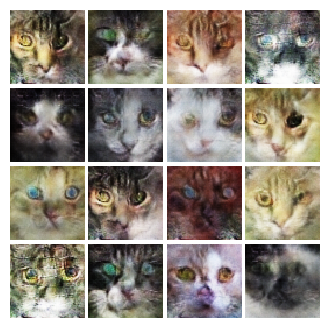


Iter: 23500, D: 0.007958, G:1.065


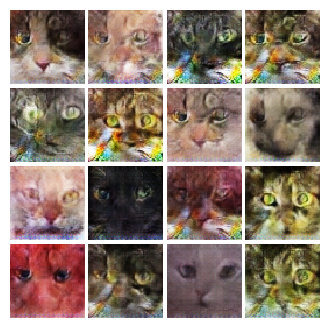


EPOCH:  49
Iter: 23750, D: 0.01218, G:0.9907


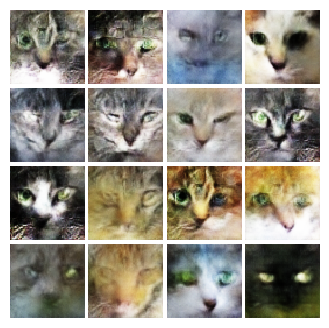


Iter: 24000, D: 0.02635, G:1.148


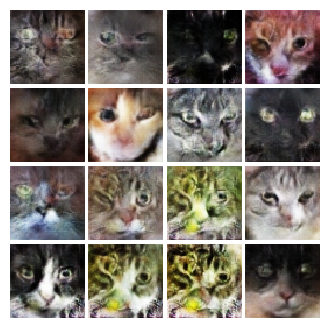


EPOCH:  50
Iter: 24250, D: 0.004966, G:0.943


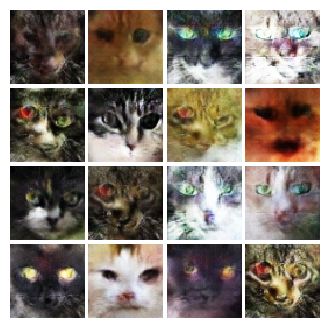


Iter: 24500, D: 0.01331, G:0.8689


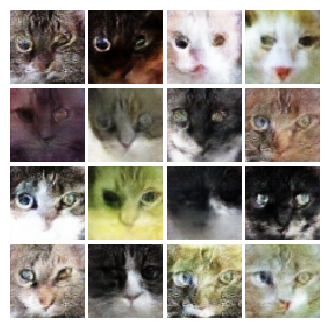

In [43]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)